In [1]:
from moviepy.editor import VideoFileClip
from IPython.display import HTML

import numpy as np
import cv2
import pylab
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob

In [2]:
def get_calibration_coef(cal_imgs, nx=9, ny=6, plot=False):
    objpoints = []
    imgpoints = []
    drawnimgs = []
    
    objp = np.zeros((nx*ny, 3), np.float32)
    objp[:,:2] = np.mgrid[0:nx, 0:ny].T.reshape(-1, 2)

    fnames = glob.glob(cal_imgs)

    for fname in fnames:
        img = mpimg.imread(fname)

        gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
        ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)

        # if chessboard corners were not found, continue to next image
        if not ret:
            continue

        # save the points to calibrate later
        imgpoints.append(corners)
        objpoints.append(objp)

        # no need to waste cycles if do not want plotting
        if not plot:
            continue

        # draw points in the img and save a copy
        cv2.drawChessboardCorners(img, (nx, ny), corners, ret)
        drawnimgs.append(img)

    return objpoints, imgpoints, drawnimgs

def calibrate(img_shape, objpoints, imgpoints):
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(
        objpoints, imgpoints, img_shape, None, None)
    return mtx, dist

def undistort(img, mtx, dist):
    return cv2.undistort(img, mtx, dist, None, mtx)

def cal_undistort(img, objpoints, imgpoints, mtx=None, dist=None):

    if not mtx or not dist:
        mtx, dist = calibrate(img.shape[0:2], objpoints, imgpoints)

    undist = undistort(img, mtx, dist)
    return undist, mtx, dist

def plot_imgs(imgs):
    fig = plt.figure(figsize=(20,50))
    for i in range(len(imgs)):
        img = imgs[i]

        ax = fig.add_subplot(9, 3, i + 1)
        ax.grid(False)
        ax.get_xaxis().set_ticks([])
        ax.get_yaxis().set_ticks([])
        ax.imshow(img)
    plt.show()

def plot_side_by_side(img1, title1, img2, title2):
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img1, cmap='gray')
    ax1.set_title(title1, fontsize=50)
    ax2.imshow(img2, cmap='gray')
    ax2.set_title(title2, fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()

def get_perspective(img_size, src=None, dst=None, inv=False):
    x, y = img_size

    if src == None or dst == None:
        src = np.float32([
                (100, y),
                (x/2 - 150, y*5/7),
                (x/2 + 150, y*5/7),
                (x - 100, y)
            ])
        dst = np.float32([
                (100, y),
                (100, 0),
                (x - 100, 0),
                (x - 100, y)
            ])
    return cv2.getPerspectiveTransform(src, dst) if not inv else cv2.getPerspectiveTransform(dst, src)

def corners_unwarp(img, mtx, dist, src=None, dst=None):
    img_size = (img.shape[1], img.shape[0])
    M = get_perspective(img_size, src, dst)
    warped = cv2.warpPerspective(img, M, img_size, flags = cv2.INTER_LINEAR)
    return warped, M

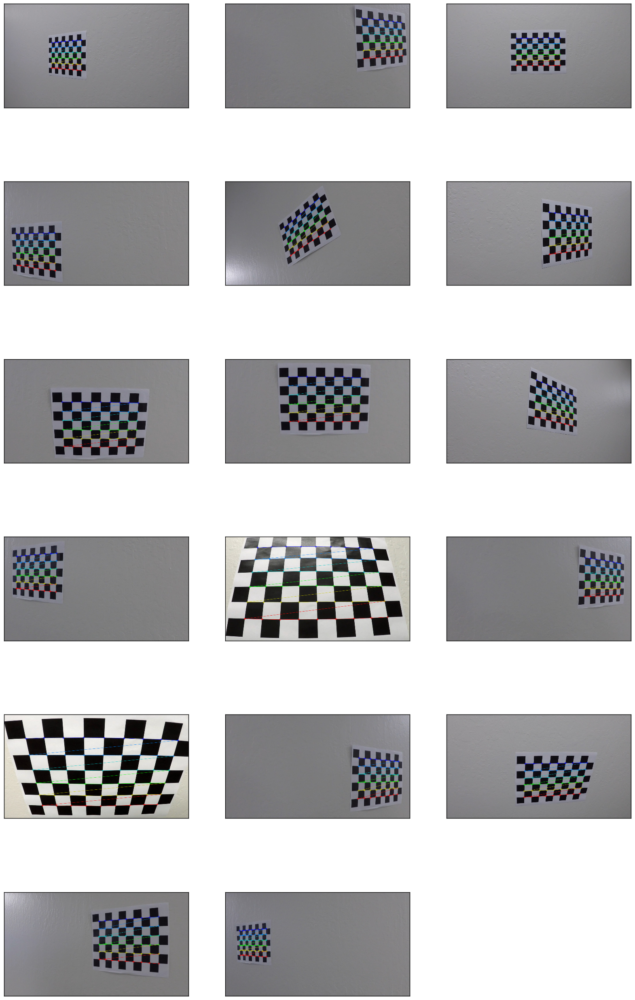

In [3]:
udobjpoints, udimgpoints, udimgs = get_calibration_coef('ud_cal/calibration*.jpg', plot=True)
plot_imgs(udimgs)

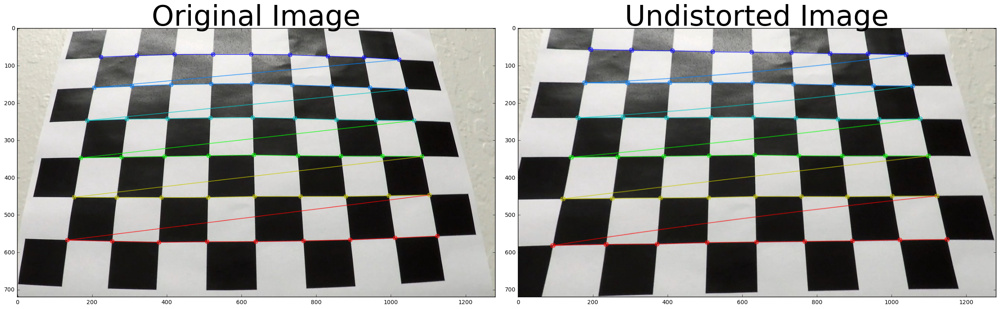

In [4]:
udimg = udimgs[10]
udundistorted, udmtx, uddist = cal_undistort(udimg, udobjpoints, udimgpoints)
plot_side_by_side(udimg, 'Original Image', udundistorted, 'Undistorted Image')

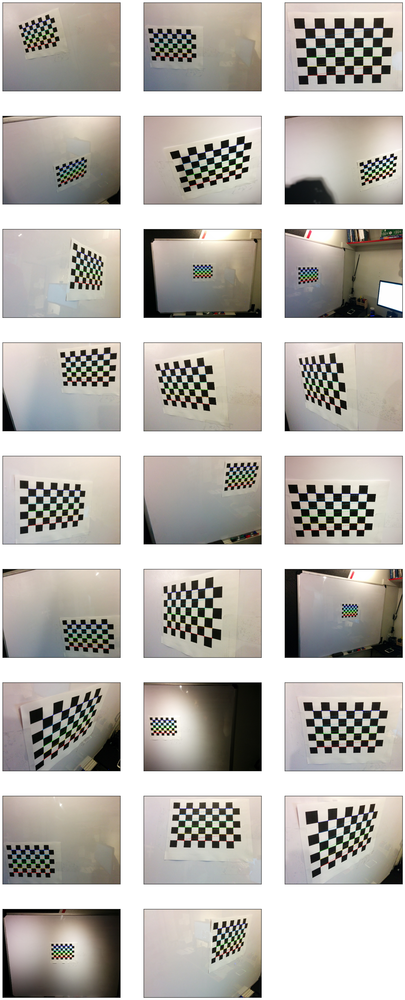

In [5]:
myobjpoints, myimgpoints, myimgs = get_calibration_coef('my_cal/calibration*.jpg', plot=True)
plot_imgs(myimgs)

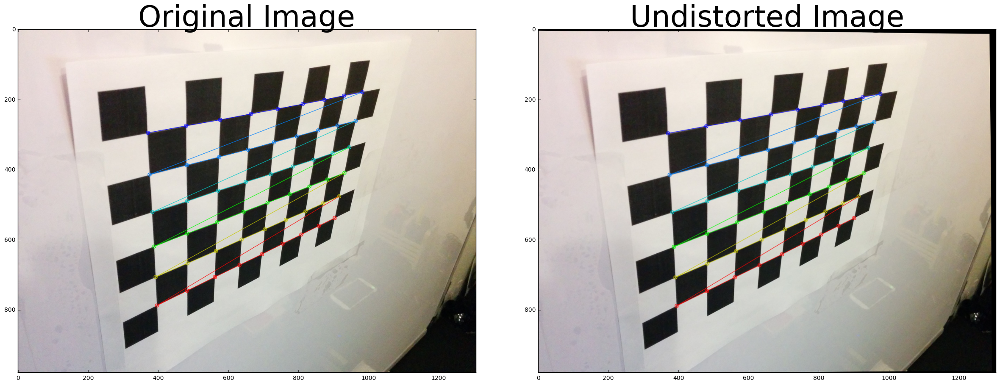

In [6]:
myimg = myimgs[-3]
myundistorted, mymtx, mydist = cal_undistort(myimg, myobjpoints, myimgpoints)
plot_side_by_side(myimg, 'Original Image', myundistorted, 'Undistorted Image')

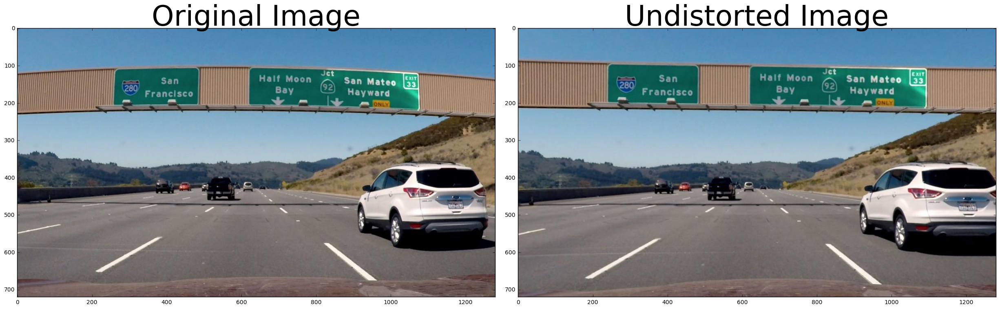

In [7]:
udimg = mpimg.imread('ud_images/signs_vehicles_xygrad.jpg')
udundistorted, udmtx, uddist = cal_undistort(udimg, udobjpoints, udimgpoints)
plot_side_by_side(udimg, 'Original Image', udundistorted, 'Undistorted Image')

In [8]:
def abs_sobel_thresh(img, orient='x', sobel_kernel=3, thresh=(0, 255)):
    # 1) Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    # 2) Take the derivative in x or y given orient = 'x' or 'y'
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    sobel = sobelx if orient == 'x' else sobely
    
    # 3) Take the absolute value of the derivative or gradient
    abs_sobel = np.absolute(sobel)
    
    # 4) Scale to 8-bit (0 - 255) then convert to type = np.uint8
    scale_factor = np.max(abs_sobel)/255 
    scaled_sobel = (abs_sobel/scale_factor).astype(np.uint8) 
    
    # 5) Create a mask of 1's where the scaled gradient magnitude 
            # is > thresh_min and < thresh_max
    binary = np.zeros_like(scaled_sobel)
    binary[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
    
    # 6) Return this mask as your binary_output image
    return binary

def mag_thresh(img, sobel_kernel=3, thresh=(0, 255)):
    # 1) Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

    # 2) Take the derivative in x or y given orient = 'x' or 'y'
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)

    # 3) Take the absolute value of the derivative or gradient
    sobel_mag = np.sqrt(np.square(sobelx) + np.square(sobely))    
    
    # 4) Scale to 8-bit (0 - 255) then convert to type = np.uint8
    scale_factor = np.max(sobel_mag)/255 
    scaled_sobel = (sobel_mag/scale_factor).astype(np.uint8) 
    
    # 5) Create a mask of 1's where the scaled gradient magnitude
    binary = np.zeros_like(scaled_sobel)
    binary[(scaled_sobel > thresh[0]) & (scaled_sobel < thresh[1])] = 1
    
    # 6) Return this mask as your binary_output image
    return binary

def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    # 1) Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    # 2) Take the gradient in x and y separately
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    
    # 3) Take the absolute value of the x and y gradients
    abs_sobelx = np.absolute(sobelx)
    abs_sobely = np.absolute(sobely)
    
    # 4) Use np.arctan2(abs_sobely, abs_sobelx) to calculate the direction of the gradient 
    dirgrad = np.arctan2(abs_sobely, abs_sobelx)
    
    # 5) Create a binary mask where direction thresholds are met
    binary = np.zeros_like(dirgrad)
    binary[(dirgrad > thresh[0]) & (dirgrad < thresh[1])] = 1
    
    # 6) Return this mask as your binary_output image
    return binary

def hls_select(img, selection='l', thresh=(0, 255)):
    # 1) Convert to HLS color space
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    H = hls[:,:,0]
    L = hls[:,:,1]
    S = hls[:,:,2]
    
    # 2) Apply a threshold to the S channel
    q = H if selection=='h' else L if selection=='l' else S
    binary = np.zeros_like(q)
    binary[(q > thresh[0]) & (q <= thresh[1])] = 1
    
    return binary

def hsv_select(img, selection='s', thresh=(0, 255)):
    # 1) Convert to HLS color space
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
    H = hsv[:,:,0]
    S = hsv[:,:,1]
    V = hsv[:,:,2]

    q = H if selection=='h' else S if selection=='s' else V
    binary = np.zeros_like(q)
    binary[(q > thresh[0]) & (q <= thresh[1])] = 1
    
    return binary

def rgb_select(img, selection='r', thresh=(0, 255)):
    # 1) Convert to HLS color space
    R = img[:,:,0]
    G = img[:,:,1]
    B = img[:,:,2]
    
    q = R if selection=='r' else G if selection=='g' else B
    binary = np.zeros_like(q)
    binary[(q > thresh[0]) & (q <= thresh[1])] = 1
        
    return binary

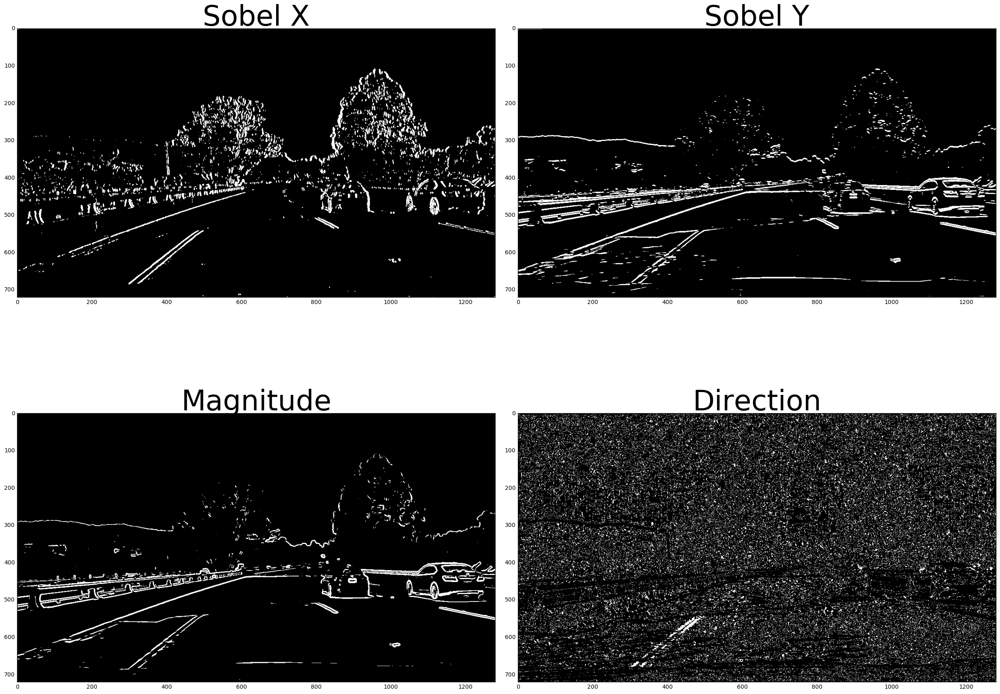

In [9]:
img = mpimg.imread('ud_images/test4.jpg')

# Choose a Sobel kernel size
ksize = 9 # Choose a larger odd number to smooth gradient measurements

# Apply each of the thresholding functions
gradx = abs_sobel_thresh(img, orient='x', sobel_kernel=ksize, thresh=(30, 255))
grady = abs_sobel_thresh(img, orient='y', sobel_kernel=ksize, thresh=(50, 255))
mag_binary = mag_thresh(img, sobel_kernel=ksize, thresh=(70, 255))
dir_binary = dir_threshold(img, sobel_kernel=ksize, thresh=(.75, 1.))

f, axs = plt.subplots(2, 2, figsize=(24, 9))
f.tight_layout()

ax1, ax2 = axs[0]
ax3, ax4 = axs[1]

ax1.imshow(gradx, cmap='gray')
ax1.set_title('Sobel X', fontsize=50)
ax2.imshow(grady, cmap='gray')
ax2.set_title('Sobel Y', fontsize=50)
ax3.imshow(mag_binary, cmap='gray')
ax3.set_title('Magnitude', fontsize=50)
ax4.imshow(dir_binary, cmap='gray')
ax4.set_title('Direction', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=2, bottom=0.)
plt.show()

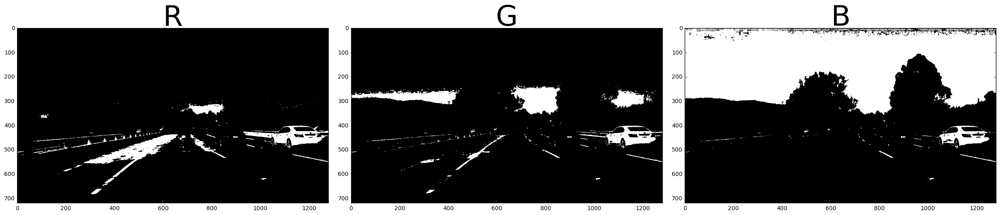

In [10]:
img = mpimg.imread('ud_images/test4.jpg')
R = rgb_select(img, selection='r', thresh=(200, 255))
G = rgb_select(img, selection='g', thresh=(200, 255))
B = rgb_select(img, selection='b', thresh=(200, 255))

f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 9))
f.tight_layout()
ax1.imshow(R, cmap='gray')
ax1.set_title('R', fontsize=50)
ax2.imshow(G, cmap='gray')
ax2.set_title('G', fontsize=50)
ax3.imshow(B, cmap='gray')
ax3.set_title('B', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
plt.show()

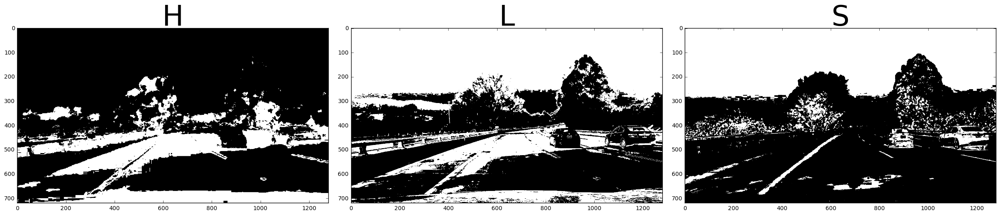

In [11]:
img = mpimg.imread('ud_images/test4.jpg')
H = hls_select(img, selection='h', thresh=(0, 20))
L = hls_select(img, selection='l', thresh=(100, 200))
S = hls_select(img, selection='s', thresh=(100, 255))

f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 9))
f.tight_layout()
ax1.imshow(H, cmap='gray')
ax1.set_title('H', fontsize=50)
ax2.imshow(L, cmap='gray')
ax2.set_title('L', fontsize=50)
ax3.imshow(S, cmap='gray')
ax3.set_title('S', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
plt.show()

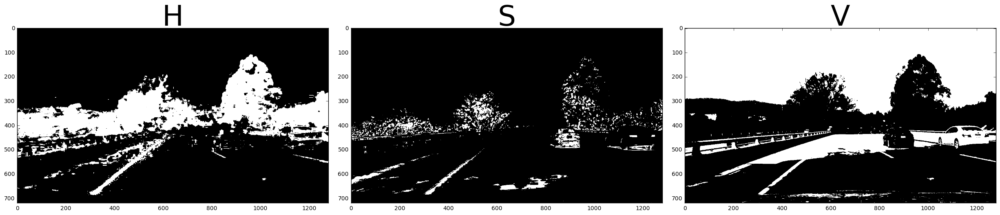

In [12]:
img = mpimg.imread('ud_images/test4.jpg')
H = hsv_select(img, selection='h', thresh=(15, 100))
S = hsv_select(img, selection='s', thresh=(150, 255))
V = hsv_select(img, selection='v', thresh=(150, 255))

f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 9))
f.tight_layout()
ax1.imshow(H, cmap='gray')
ax1.set_title('H', fontsize=50)
ax2.imshow(S, cmap='gray')
ax2.set_title('S', fontsize=50)
ax3.imshow(V, cmap='gray')
ax3.set_title('V', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
plt.show()

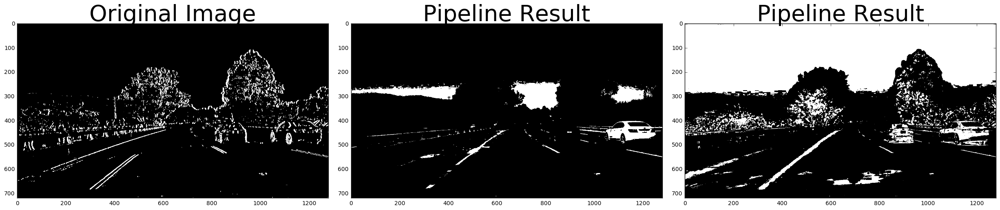

In [13]:
# Edit this function to create your own pipeline.
def pipeline(img):
    img = np.copy(img)
    
    gradx = abs_sobel_thresh(img, orient='x', sobel_kernel=9, thresh=(30, 255))
    S = hls_select(img, selection='s', thresh=(100, 255))
    G = rgb_select(img, selection='g', thresh=(200, 255))
    
    color_binary = np.zeros(S.shape + (3,), dtype=int)
    color_binary[:,:,0] = gradx
    color_binary[:,:,1] = G
    color_binary[:,:,2] = S
    return color_binary, gradx, G, S


image = mpimg.imread('ud_images/test4.jpg')
result, l1, l2, l3 = pipeline(image)

# Plot the result
f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 9))
f.tight_layout()

ax1.imshow(l1, cmap='gray')
ax1.set_title('Original Image', fontsize=40)

ax2.imshow(l2, cmap='gray')
ax2.set_title('Pipeline Result', fontsize=40)

ax3.imshow(l3, cmap='gray')
ax3.set_title('Pipeline Result', fontsize=40)

plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
plt.show()

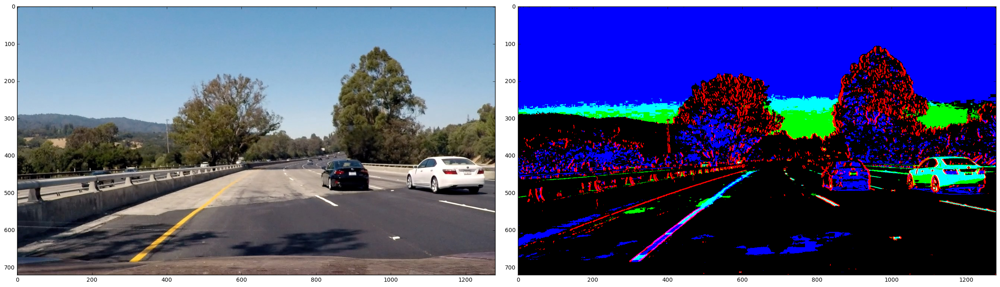

In [14]:
plot_side_by_side(image, '', result, '')

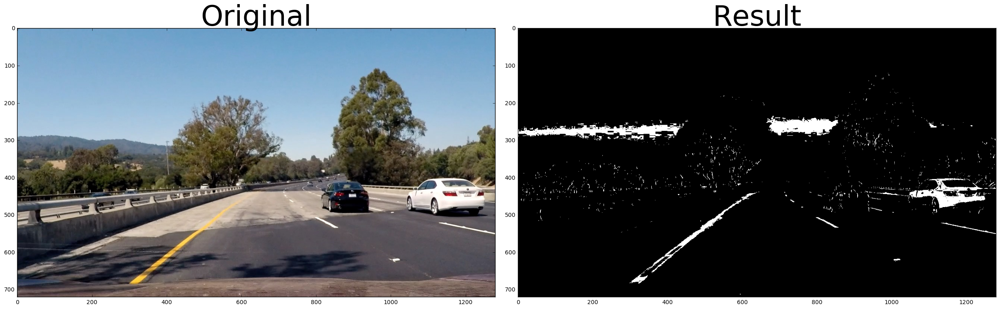

In [15]:
result = (l1 | l2) & l3

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(image, cmap='gray')
ax1.set_title('Original', fontsize=50)
ax2.imshow(result, cmap='gray')
ax2.set_title('Result', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
plt.show()

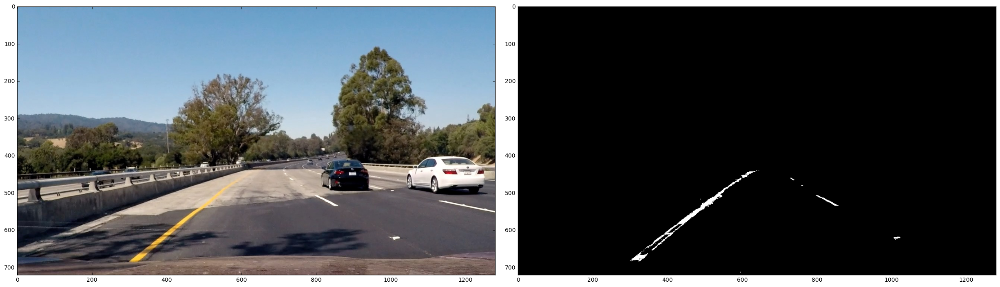

In [16]:
def region_of_interest(img, vertices):
    """
    Applies an image mask.
    
    Only keeps the region of the image defined by the polygon
    formed from `vertices`. The rest of the image is set to black.
    """
    #defining a blank mask to start with
    mask = np.zeros_like(img)   
    
    #defining a 3 channel or 1 channel color to fill the mask with depending on the input image
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255,) * channel_count
    else:
        ignore_mask_color = 255
        
    #filling pixels inside the polygon defined by "vertices" with the fill color    
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    
    #returning the image only where mask pixels are nonzero
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image

def line_intersection(line1, line2):
    xdiff = (line1[0][0] - line1[1][0], line2[0][0] - line2[1][0])
    ydiff = (line1[0][1] - line1[1][1], line2[0][1] - line2[1][1]) #Typo was here

    def det(a, b):
        return a[0] * b[1] - a[1] * b[0]

    div = det(xdiff, ydiff)
    if div == 0:
       raise Exception('lines do not intersect')

    d = (det(*line1), det(*line2))
    x = det(d, xdiff) / div
    y = det(d, ydiff) / div
    return x, y

img_size = (img.shape[1], img.shape[0])    
x, y = img_size

A1 = (50, y)
B1 = (x/2, y/2+50)

A2 = (x-50, y)
B2 = (x/2, y/2+50)

vertices = np.array([[
        A1, B1, B2, A2
    ]], dtype=np.int32)

poly = region_of_interest(result, vertices)

C = (0, int(y*5/7))
D = (x, int(y*5/7))

L = tuple(np.array(line_intersection((A1, B1), (C, D)), dtype=int))
R = tuple(np.array(line_intersection((A2, B2), (C, D)), dtype=int))

#cv2.line(poly, L, R, (255,0,0), 5)

plot_side_by_side(image, '', poly, '')

[[   50.   720.]
 [  442.   514.]
 [  837.   514.]
 [ 1230.   720.]]


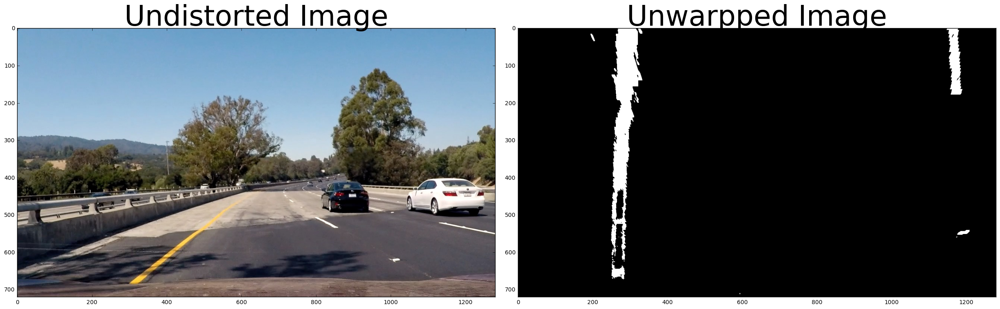

In [17]:
src = np.float32([A1, L, R, A2])
dst = np.float32([
        (50, y),
        (50, 0),
        (x-50, 0),
        (x-50, y)
    ])
print(src)
unwarpped, M = corners_unwarp(poly, udmtx, uddist, src, dst)
plot_side_by_side(image, 'Undistorted Image', unwarpped, 'Unwarpped Image')

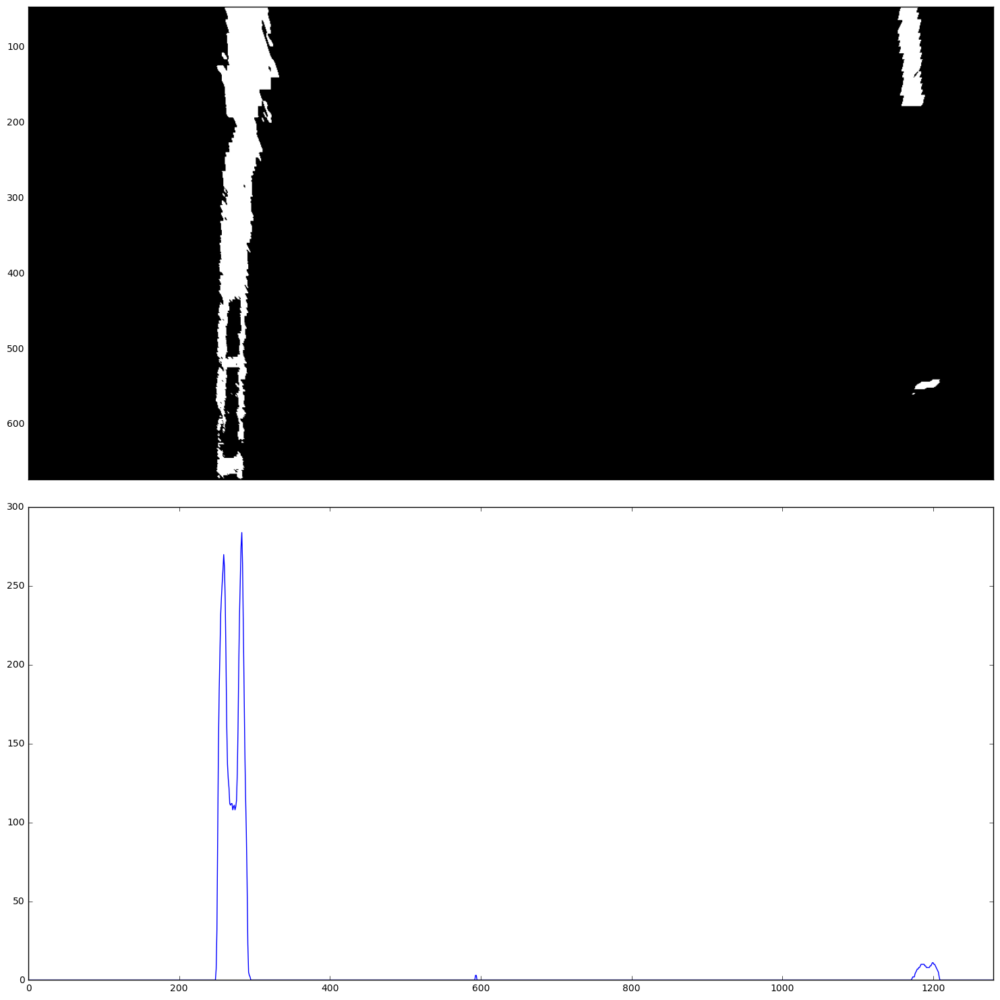

In [18]:
histogram = np.sum(unwarpped[unwarpped.shape[0]/2:,:], axis=0)

f, (ax1, ax2) = plt.subplots(2, 1, figsize=(15, 15))
f.tight_layout()
ax1.imshow(unwarpped, cmap='gray')
plt.setp(ax1.get_xticklabels(), visible=False)
ax2 = plt.subplot(212, sharex=ax1)
plt.plot(histogram)
plt.xlim(0, x)
plt.show()

(top, bottom)=(700,727)
(top, bottom)=(672,699)
(top, bottom)=(644,671)
(top, bottom)=(616,643)
(top, bottom)=(588,615)
(top, bottom)=(560,587)
(top, bottom)=(532,559)
(top, bottom)=(504,531)
(top, bottom)=(476,503)
(top, bottom)=(448,475)
(top, bottom)=(420,447)
(top, bottom)=(392,419)
(top, bottom)=(364,391)
(top, bottom)=(336,363)
(top, bottom)=(308,335)
(top, bottom)=(280,307)
(top, bottom)=(252,279)
(top, bottom)=(224,251)
(top, bottom)=(196,223)
(top, bottom)=(168,195)
(top, bottom)=(140,167)
(top, bottom)=(112,139)
(top, bottom)=(84,111)
(top, bottom)=(56,83)
(top, bottom)=(28,55)
(top, bottom)=(0,27)


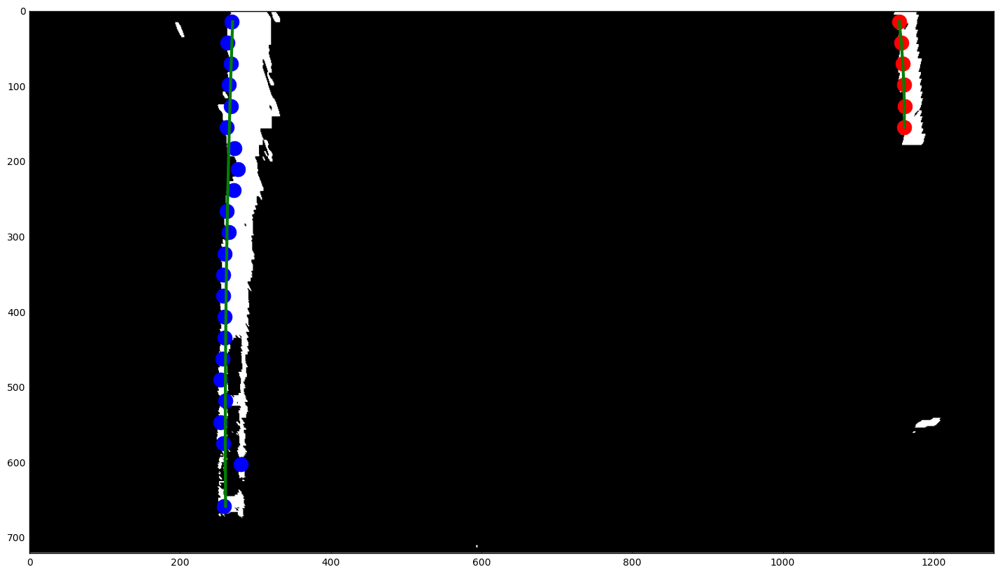

In [19]:
NUM_BANDS = 25
TRACK_THRESHOLD = 20
BOX_HALF_WIDTH = 50

def find_point(histogram_, avg_height_, is_initialized_, min_edge_, max_edge_, last_center_, list_):
    # decide width to look in for max
    if is_initialized_ == True:
        left_edge = last_center_ - BOX_HALF_WIDTH
        right_edge = last_center_ + BOX_HALF_WIDTH            
    else:
        left_edge = min_edge_
        right_edge = max_edge_

    #print('\t(L_edge,R_edge)=({},{})'.format(left_edge, right_edge))
    # find the max
    center_guess = np.argmax(histogram_[left_edge:right_edge])+left_edge
    center_value = histogram_[center_guess]
    #print('\tcenter_guess: ', center_guess)
    #print('\tcenter_value: ', center_value)
    if center_value > TRACK_THRESHOLD:
        #print('\tappending...')
        list_.append((center_guess, avg_height_))
        last_center_ = center_guess
        if is_initialized_ == False:
            is_initialized_ = True

    return is_initialized_, last_center_, list_



def get_lane_points(img_):
    left = []
    right = []
    
    #band_start = img_.shape[0]
    band_depth = int(img_.shape[0]/NUM_BANDS)
    
    tops = np.arange(0, img_.shape[0]-1, band_depth)
    bottoms = tops + (band_depth-1)
    
    # reverse the arrays
    tops = tops[::-1]
    bottoms = bottoms[::-1]
    
    is_left_initialized = False
    is_right_initialized = False
    last_left_center = 0
    last_right_center = 0
    
    for index in range(len(tops)):
        print('(top, bottom)=({},{})'.format(tops[index], bottoms[index]))
        histogram = np.sum(img_[tops[index]:bottoms[index],:], axis=0)
        hist_len = histogram.shape[0]
        avg_height = (tops[index] + bottoms[index])/2

        is_left_initialized, last_left_center, left = find_point(histogram,
                                                                 avg_height,
                                                                 is_left_initialized, 
                                                                 0, 
                                                                 int(hist_len/2), 
                                                                 last_left_center, 
                                                                 left)
        
        is_right_initialized, last_right_center, right = find_point(histogram,
                                                                 avg_height,
                                                                 is_right_initialized, 
                                                                 int(hist_len/2), 
                                                                 hist_len-1, 
                                                                 last_right_center, 
                                                                 right)
            
    #print(left)
    
    return left, right
    

def fit_curve(points_):
    # get x and y values
    x_vals = np.asarray([pt_tuple[0] for pt_tuple in points_])
    y_vals = np.asarray([pt_tuple[1] for pt_tuple in points_])
    # Fit a second order polynomial
    fit_coeff = np.polyfit(y_vals, x_vals, 2)
    x_fit = fit_coeff[0]*y_vals**2 + fit_coeff[1]*y_vals + fit_coeff[2]
    return x_fit, y_vals, fit_coeff

def add_points(fig_, points_, marking_):
    for pt_tuple in points_:
        fig_.plot(pt_tuple[0],pt_tuple[1],marking_, markersize=30)

# find the curve
left, right = get_lane_points(unwarpped)
left_fitx, left_valsy, _ = fit_curve(left)
right_fitx, right_valsy, _ = fit_curve(right)

f, (ax1) = plt.subplots(1, 1, figsize=(20,10))
ax1.set_title('')
ax1.imshow(unwarpped, cmap='gray')
add_points(ax1, left, 'b.')
add_points(ax1, right, 'r.')
plt.xlim(0, 1280)
plt.ylim(0, 720)
plt.plot(left_fitx, left_valsy, color='green', linewidth=3)
plt.plot(right_fitx, right_valsy, color='green', linewidth=3)
plt.gca().invert_yaxis() # to visualize as we do the images
plt.show()

In [20]:
connectivity = 4  
# Perform the operation
output = cv2.connectedComponentsWithStats(unwarpped, connectivity, cv2.CV_32S)
# Get the results
# The first cell is the number of labels
num_labels = output[0]
# The second cell is the label matrix
labels = output[1]
# The third cell is the stat matrix
stats = output[2]
# The fourth cell is the centroid matrix
centroids = output[3]

print(num_labels, labels, stats, centroids)

22 [[0 0 0 ..., 0 0 0]
 [0 0 0 ..., 0 0 0]
 [0 0 0 ..., 0 0 0]
 ..., 
 [0 0 0 ..., 0 0 0]
 [0 0 0 ..., 0 0 0]
 [0 0 0 ..., 0 0 0]] [[     0      0   1280    720 892340]
 [   249      0     84    621  23178]
 [   321      0     12     16    120]
 [  1147      0     42    179   4542]
 [   194     16     12     20    107]
 [   257    108      7      9     41]
 [   310    194      3      6     10]
 [   258    294      3      5      9]
 [  1175    541     34     13    270]
 [   269    559      2      2      2]
 [  1172    559      4      2      6]
 [   264    583      3      3      4]
 [   254    589      3      2      5]
 [   258    606      3      6     12]
 [   251    612      3      4      7]
 [   252    618      4      5     11]
 [   283    623      3      2      5]
 [   252    625      8      6     23]
 [   250    632     37     42    891]
 [   259    641      2      2      2]
 [   251    668      4      4      9]
 [   593    710      2      3      6]] [[  646.42868974   363.68339086]

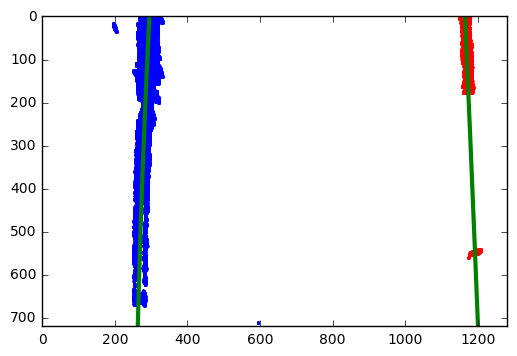

In [21]:
left = np.zeros_like(unwarpped)
left[:,:unwarpped.shape[1]//2] = unwarpped[:,:unwarpped.shape[1]//2]

right = np.zeros_like(unwarpped)
right[:,unwarpped.shape[1]//2:] = unwarpped[:,unwarpped.shape[1]//2:]

lpoints = cv2.findNonZero(left)
rpoints = cv2.findNonZero(right)

lyvals = lpoints[:,:,1].squeeze()
ryvals = rpoints[:,:,1].squeeze()

# Fit a second order polynomial to each fake lane line
left_fit = np.polyfit(lyvals, lpoints[:,:,0].squeeze(), 2)
#left_fitx = left_fit[0]*lyvals**2 + left_fit[1]*lyvals + left_fit[2]
left_fitx = left_fit[0]*np.arange(720)**2 + left_fit[1]*np.arange(720) + left_fit[2]

right_fit = np.polyfit(ryvals, rpoints[:,:,0].squeeze(), 2)
#right_fitx = right_fit[0]*ryvals**2 + right_fit[1]*ryvals + right_fit[2]
right_fitx = right_fit[0]*np.arange(720)**2 + right_fit[1]*np.arange(720) + right_fit[2]

plt.plot(lpoints[:,:,0].squeeze(), lpoints[:,:,1].squeeze(), 'b.', markersize=3)
plt.plot(rpoints[:,:,0].squeeze(), rpoints[:,:,1].squeeze(), 'r.', markersize=3)

plt.xlim(0, 1280)
plt.ylim(0, 720)
plt.plot(left_fitx, np.arange(720), color='green', linewidth=3)
plt.plot(right_fitx, np.arange(720), color='green', linewidth=3)
plt.gca().invert_yaxis() # to visualize as we do the images
plt.show()

In [22]:
# Define y-value where we want radius of curvature
# I'll choose the maximum y-value, corresponding to the bottom of the image
ly_eval = np.max(lpoints[:,:,1].squeeze())
ry_eval = np.max(rpoints[:,:,1].squeeze())
print(ly_eval, ry_eval)

left_curverad = ((1 + (2*left_fit[0]*ly_eval + left_fit[1])**2)**1.5) \
                             /np.absolute(2*left_fit[0])
right_curverad = ((1 + (2*right_fit[0]*ry_eval + right_fit[1])**2)**1.5) \
                                /np.absolute(2*right_fit[0])
print(left_curverad, right_curverad)
# Example values: 1163.9    1213.7

712 560
24472.0532224 133818.73822


In [23]:
# Define conversions in x and y from pixels space to meters
ym_per_pix = 30/720 # meters per pixel in y dimension
xm_per_pix = 3.7/700 # meteres per pixel in x dimension

ly_eval = np.max(lpoints[:,:,1].squeeze())
ry_eval = np.max(rpoints[:,:,1].squeeze())

left_fit_cr = np.polyfit(lpoints[:,:,1].squeeze()*ym_per_pix, lpoints[:,:,0].squeeze()*xm_per_pix, 2)
right_fit_cr = np.polyfit(rpoints[:,:,1].squeeze()*ym_per_pix, rpoints[:,:,0].squeeze()*xm_per_pix, 2)

left_curverad = ((1 + (2*left_fit_cr[0]*ly_eval + left_fit_cr[1])**2)**1.5) \
                             /np.absolute(2*left_fit_cr[0])
right_curverad = ((1 + (2*right_fit_cr[0]*ry_eval + right_fit_cr[1])**2)**1.5) \
                                /np.absolute(2*right_fit_cr[0])
# Now our radius of curvature is in meters
print(left_curverad, 'm', right_curverad, 'm')
# Example values: 3380.7 m    3189.3 m

8106.73784603 m 43803.8355134 m


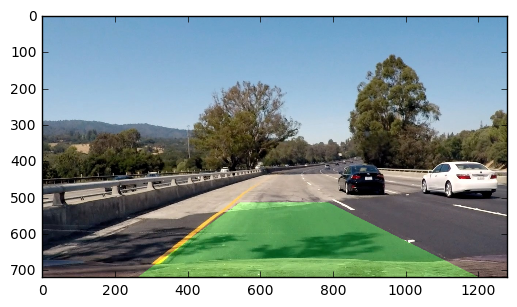

In [24]:
warped = unwarpped
# Create an image to draw the lines on
warp_zero = np.zeros_like(warped).astype(np.uint8)
color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

# Recast the x and y points into usable format for cv2.fillPoly()
pts_left = np.array([np.transpose(np.vstack([left_fitx, np.arange(720)]))])
pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, np.arange(720)])))])
pts = np.hstack((pts_left, pts_right))

# Draw the lane onto the warped blank image
cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

Minv = get_perspective(img_size, inv=True)
# Warp the blank back to original image space using inverse perspective matrix (Minv)
newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0])) 
# Combine the result with the original image
result = cv2.addWeighted(image, 1, newwarp, 0.3, 0)
plt.imshow(result)
plt.show()

In [25]:
def pipeline(img):
    img = np.copy(img)
    img, _, _ = cal_undistort(udimg, udobjpoints, udimgpoints)
    gradx = abs_sobel_thresh(img, orient='x', sobel_kernel=9, thresh=(30, 255))
    S = hls_select(img, selection='s', thresh=(100, 255))
    G = rgb_select(img, selection='g', thresh=(200, 255))
    
    mask = (gradx | G) & S
    return mask

In [26]:
challenge_output = 'ud_videos/project_video_out.mp4'
clip2 = VideoFileClip('ud_videos/project_video.mp4')
challenge_clip = clip2.fl_image(pipeline)
%time challenge_clip.write_videofile(challenge_output, audio=False)

[MoviePy] >>>> Building video ud_videos/project_video_out.mp4
[MoviePy] Writing video ud_videos/project_video_out.mp4


100%|█████████▉| 1260/1261 [25:46<00:01,  1.21s/it]

[MoviePy] Done.
[MoviePy] >>>> Video ready: ud_videos/project_video_out.mp4 

CPU times: user 45min 25s, sys: 7.07 s, total: 45min 33s
Wall time: 25min 46s


In [27]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(challenge_output))